# **Getting dataset**

In [ ]:
import pandas as pd
import gzip
false=False
true=True

def parse(path):
  g = gzip.open('/content/Magazine_Subscriptions.json.gz', 'rb')
  for l in g:
    yield eval(l)

def getDF(path):
  i = 0
  df = {}
  for d in parse(path):
    df[i] = d
    i += 1
  return pd.DataFrame.from_dict(df, orient='index')

df = getDF('Magazine_Subscriptions.json.gz')

Total Number of Magazine Subscriptions reviews 

In [ ]:
len(df)

89689

Total Number of reviews taken in consideration 

In [ ]:
df=df[:25000]
len(df)

25000

In [ ]:
df.head()

,overall,vote,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime,style,image,Sentiment,Binary_Sentiment
0,5.0,9,False,"11 8, 2001",AH2IFH762VY5U,B00005N7P0,ted sedlmayr,"for computer enthusiast, MaxPC is a welcome si...","AVID READER SINCE ""boot"" WAS THE NAME",1005177600,NaN,NaN,Positive,1.0
1,5.0,9,False,"10 31, 2001",AOSFI0JEYU4XM,B00005N7P0,Amazon Customer,Thank god this is not a Ziff Davis publication...,The straight scoop,1004486400,NaN,NaN,Positive,1.0
2,3.0,14,False,"03 24, 2007",A3JPFWKS83R49V,B00005N7OJ,Bryan Carey,Antiques Magazine is a publication made for an...,"Antiques Magazine is Good, but not for Everyone",1174694400,{'Format:': ' Print Magazine'},NaN,Negative,0.0
3,5.0,13,False,"11 10, 2006",A19FKU6JZQ2ECJ,B00005N7OJ,Patricia L. Porada,This beautiful magazine is in itself a work of...,THE DISCERNING READER,1163116800,{'Format:': ' Print Magazine'},NaN,Positive,1.0
4,5.0,NaN,True,"07 14, 2014",A25MDGOMZ2GALN,B00005N7P0,Alvey,A great read every issue.,Five Stars,1405296000,NaN,NaN,Positive,1.0


Adding a column for Positive and Negative Sentiment

In [ ]:
df.loc[df['overall']<=3, 'Sentiment']='Negative'
df.loc[df['overall']>3, 'Sentiment']='Positive'
df.head()

,overall,vote,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime,style,image,Sentiment
0,5.0,9,False,"11 8, 2001",AH2IFH762VY5U,B00005N7P0,ted sedlmayr,"for computer enthusiast, MaxPC is a welcome si...","AVID READER SINCE ""boot"" WAS THE NAME",1005177600,NaN,NaN,Positive
1,5.0,9,False,"10 31, 2001",AOSFI0JEYU4XM,B00005N7P0,Amazon Customer,Thank god this is not a Ziff Davis publication...,The straight scoop,1004486400,NaN,NaN,Positive
2,3.0,14,False,"03 24, 2007",A3JPFWKS83R49V,B00005N7OJ,Bryan Carey,Antiques Magazine is a publication made for an...,"Antiques Magazine is Good, but not for Everyone",1174694400,{'Format:': ' Print Magazine'},NaN,Negative
3,5.0,13,False,"11 10, 2006",A19FKU6JZQ2ECJ,B00005N7OJ,Patricia L. Porada,This beautiful magazine is in itself a work of...,THE DISCERNING READER,1163116800,{'Format:': ' Print Magazine'},NaN,Positive
4,5.0,NaN,True,"07 14, 2014",A25MDGOMZ2GALN,B00005N7P0,Alvey,A great read every issue.,Five Stars,1405296000,NaN,NaN,Positive


Adding a column for Sentiments in binary form

In [ ]:
df.loc[df['Sentiment']=='Negative', 'Binary_Sentiment']=0
df.loc[df['Sentiment']=='Positive', 'Binary_Sentiment']=1
df.head()

,overall,vote,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime,style,image,Sentiment,Binary_Sentiment
0,5.0,9,False,"11 8, 2001",AH2IFH762VY5U,B00005N7P0,ted sedlmayr,"for computer enthusiast, MaxPC is a welcome si...","AVID READER SINCE ""boot"" WAS THE NAME",1005177600,NaN,NaN,Positive,1.0
1,5.0,9,False,"10 31, 2001",AOSFI0JEYU4XM,B00005N7P0,Amazon Customer,Thank god this is not a Ziff Davis publication...,The straight scoop,1004486400,NaN,NaN,Positive,1.0
2,3.0,14,False,"03 24, 2007",A3JPFWKS83R49V,B00005N7OJ,Bryan Carey,Antiques Magazine is a publication made for an...,"Antiques Magazine is Good, but not for Everyone",1174694400,{'Format:': ' Print Magazine'},NaN,Negative,0.0
3,5.0,13,False,"11 10, 2006",A19FKU6JZQ2ECJ,B00005N7OJ,Patricia L. Porada,This beautiful magazine is in itself a work of...,THE DISCERNING READER,1163116800,{'Format:': ' Print Magazine'},NaN,Positive,1.0
4,5.0,NaN,True,"07 14, 2014",A25MDGOMZ2GALN,B00005N7P0,Alvey,A great read every issue.,Five Stars,1405296000,NaN,NaN,Positive,1.0


In [ ]:
df.tail()

,overall,vote,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime,style,image,Sentiment,Binary_Sentiment
24995,5.0,NaN,True,"03 24, 2015",A1AG7VJ1T35X77,B00005QJE0,Darrin R. West,Gorgeous large format magazine. Very inspiring...,Gorgeous and Inspiring.,1427155200,{'Format:': ' Print Magazine'},NaN,Positive,1.0
24996,4.0,NaN,True,"07 30, 2014",A365DG6L5EUQQB,B00005QJE0,Charles Belew,Very happy with our subscribtions!,Four Stars,1406678400,{'Format:': ' Print Magazine'},NaN,Positive,1.0
24997,5.0,NaN,True,"02 26, 2014",A312FAW297PIOZ,B00005QJE0,kwilson,Love advice on gardening and the different gar...,Would. recommend this magazine to everyone .,1393372800,{'Format:': ' Print Magazine'},NaN,Positive,1.0
24998,5.0,NaN,True,"04 4, 2013",AUHOX5LLRIF11,B00005QJE0,Amazon Customer,photos are so good I look at these mags over a...,best gardening magazine,1365033600,{'Format:': ' Print Magazine'},NaN,Positive,1.0
24999,5.0,4,True,"02 6, 2013",A2P4CPM9S3QBDU,B00005QJE0,Linda W Owen,The English Garden is a wonderful gardening ma...,"The English Garden, good magizine for Americans",1360108800,{'Format:': ' Print Magazine'},NaN,Positive,1.0


# **MODULE-1(STATISTICS)--------------------------------------**

In [ ]:
from collections import Counter
all_data=["".join(str(x).replace("'","")) for x in df['reviewText']]
collect_data=""
for i in all_data:
  collect_data=collect_data+" "+i
collect_data

' for computer enthusiast, MaxPC is a welcome sight in your mailbox. i can remember for years savorying every page of "boot" (as it was called in beginning) as i was (and still am) obcessed with PCs. Anyone, from advanced users - to beginners looking for knowledge - can profit from every issue of MaxPC. the icing on the cake is the subscription that comes with a CD-ROM as it is packed with demos, utilities, and other useful apps (very helpful for those not blessed with broadband connections). Until I discovered the community of hardware enthusiast web sites, MaxPC, formerly "boot", was my only really informative source for computing news and articles. To this day, i consider my subscription to it worth more than 10 subscriptions to most other computing mags. I cant wait until they merge with DVD media and maybe end up offering more info on Divx codecs, encoding your own movies, and best bang for the buck audio and video equipment. Try a few issues (with CD)and you may get hooked... Tha

**1. Text Pre-processing methods:**

(i) Removing the punctuations

In [ ]:
import re
s=str(collect_data)
# Remove all non-word characters (everything except numbers and letters)
s = re.sub(r"[^\w\s]", '', s)
# replace digits with no space
s = re.sub(r"\d", '', s)
s=s.replace("\n", "")
s

' for computer enthusiast MaxPC is a welcome sight in your mailbox i can remember for years savorying every page of boot as it was called in beginning as i was and still am obcessed with PCs Anyone from advanced users  to beginners looking for knowledge  can profit from every issue of MaxPC the icing on the cake is the subscription that comes with a CDROM as it is packed with demos utilities and other useful apps very helpful for those not blessed with broadband connections Until I discovered the community of hardware enthusiast web sites MaxPC formerly boot was my only really informative source for computing news and articles To this day i consider my subscription to it worth more than  subscriptions to most other computing mags I cant wait until they merge with DVD media and maybe end up offering more info on Divx codecs encoding your own movies and best bang for the buck audio and video equipment Try a few issues with CDand you may get hooked Thank god this is not a Ziff Davis publi

(ii)Lowercasing all the words

In [ ]:
s=s.lower()
s

' for computer enthusiast maxpc is a welcome sight in your mailbox i can remember for years savorying every page of boot as it was called in beginning as i was and still am obcessed with pcs anyone from advanced users  to beginners looking for knowledge  can profit from every issue of maxpc the icing on the cake is the subscription that comes with a cdrom as it is packed with demos utilities and other useful apps very helpful for those not blessed with broadband connections until i discovered the community of hardware enthusiast web sites maxpc formerly boot was my only really informative source for computing news and articles to this day i consider my subscription to it worth more than  subscriptions to most other computing mags i cant wait until they merge with dvd media and maybe end up offering more info on divx codecs encoding your own movies and best bang for the buck audio and video equipment try a few issues with cdand you may get hooked thank god this is not a ziff davis publi

(iii)Tokenization

In [ ]:
import nltk
from nltk.tokenize import word_tokenize
from nltk.tokenize import punkt
nltk.download('punkt')
word_tokens = word_tokenize(s)
word_tokens

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


['for',
 'computer',
 'enthusiast',
 'maxpc',
 'is',
 'a',
 'welcome',
 'sight',
 'in',
 'your',
 'mailbox',
 'i',
 'can',
 'remember',
 'for',
 'years',
 'savorying',
 'every',
 'page',
 'of',
 'boot',
 'as',
 'it',
 'was',
 'called',
 'in',
 'beginning',
 'as',
 'i',
 'was',
 'and',
 'still',
 'am',
 'obcessed',
 'with',
 'pcs',
 'anyone',
 'from',
 'advanced',
 'users',
 'to',
 'beginners',
 'looking',
 'for',
 'knowledge',
 'can',
 'profit',
 'from',
 'every',
 'issue',
 'of',
 'maxpc',
 'the',
 'icing',
 'on',
 'the',
 'cake',
 'is',
 'the',
 'subscription',
 'that',
 'comes',
 'with',
 'a',
 'cdrom',
 'as',
 'it',
 'is',
 'packed',
 'with',
 'demos',
 'utilities',
 'and',
 'other',
 'useful',
 'apps',
 'very',
 'helpful',
 'for',
 'those',
 'not',
 'blessed',
 'with',
 'broadband',
 'connections',
 'until',
 'i',
 'discovered',
 'the',
 'community',
 'of',
 'hardware',
 'enthusiast',
 'web',
 'sites',
 'maxpc',
 'formerly',
 'boot',
 'was',
 'my',
 'only',
 'really',
 'informativ

(iv)Removing stop words


In [ ]:
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
print(stopwords.words('english'))

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'bo

In [ ]:
stop_words = set(stopwords.words('english'))   
 
filtered_words = []  
  
for w in word_tokens:  
    if w not in stop_words:  
        filtered_words.append(w)  
  
fs = pd.DataFrame(filtered_words)
fs
filtered_words

['computer',
 'enthusiast',
 'maxpc',
 'welcome',
 'sight',
 'mailbox',
 'remember',
 'years',
 'savorying',
 'every',
 'page',
 'boot',
 'called',
 'beginning',
 'still',
 'obcessed',
 'pcs',
 'anyone',
 'advanced',
 'users',
 'beginners',
 'looking',
 'knowledge',
 'profit',
 'every',
 'issue',
 'maxpc',
 'icing',
 'cake',
 'subscription',
 'comes',
 'cdrom',
 'packed',
 'demos',
 'utilities',
 'useful',
 'apps',
 'helpful',
 'blessed',
 'broadband',
 'connections',
 'discovered',
 'community',
 'hardware',
 'enthusiast',
 'web',
 'sites',
 'maxpc',
 'formerly',
 'boot',
 'really',
 'informative',
 'source',
 'computing',
 'news',
 'articles',
 'day',
 'consider',
 'subscription',
 'worth',
 'subscriptions',
 'computing',
 'mags',
 'cant',
 'wait',
 'merge',
 'dvd',
 'media',
 'maybe',
 'end',
 'offering',
 'info',
 'divx',
 'codecs',
 'encoding',
 'movies',
 'best',
 'bang',
 'buck',
 'audio',
 'video',
 'equipment',
 'try',
 'issues',
 'cdand',
 'may',
 'get',
 'hooked',
 'thank',


(v)Lemmatization

In [ ]:
nltk.download('wordnet')
from nltk.stem import wordnet 
from nltk.stem import WordNetLemmatizer
word_lemma=WordNetLemmatizer()
count=0
for words in filtered_words:
  lemm_words=word_lemma.lemmatize(words)
  print(lemm_words)
  count+=1



Streaming output truncated to the last 5000 lines.
heard
want
practice
french
read
mot
mot
french
english
magazine
want
keep
reading
magazine
great
way
dream
place
france
culture
food
language
art
event
even
politics
ive
used
plan
two
trip
france
great
magazineif
love
france
right
thing
youvery
good
tip
nice
place
go
love
magazine
every
page
something
interest
photo
beautiful
inspiring
full
helpful
tip
suggestion
traveling
staying
france
particularly
love
section
improvinglearnign
french
language
well
deep
dive
various
arrondisements
paris
magazine
cover
france
wonderful
discovered
many
place
still
want
visit
magazine
keep
every
issue
reread
time
time
love
th
magazine
subscribed
year
master
degree
french
visit
france
frequently
unfortunately
magazine
written
french
expensive
subscribe
would
recommend
magazine
anyone
love
travel
france
europe
nice
english
language
magazine
love
france
great
travel
information
nice
cultural
tidbit
well
even
feature
french
area
outside
france
montreal
wou

In [ ]:
len(filtered_words)

590118

In [ ]:
filtered_sentence_string = (filtered_words)

In [ ]:
filtered_sentence_string = str(filtered_sentence_string)
type(filtered_sentence_string)
filtered_sentence_string = re.sub(r"[^\w\s]", '', filtered_sentence_string)
filtered_sentence_string

'computer enthusiast maxpc welcome sight mailbox remember years savorying every page boot called beginning still obcessed pcs anyone advanced users beginners looking knowledge profit every issue maxpc icing cake subscription comes cdrom packed demos utilities useful apps helpful blessed broadband connections discovered community hardware enthusiast web sites maxpc formerly boot really informative source computing news articles day consider subscription worth subscriptions computing mags cant wait merge dvd media maybe end offering info divx codecs encoding movies best bang buck audio video equipment try issues cdand may get hooked thank god ziff davis publication maxpc actually tell product bad print think something sugar coating would compare style car driver technical know good time antiques magazine publication made antique lovers history buffs pages loaded photos artistic paintings handmade goods rare pictures items similar nature magazine love antiques also consider historians sin

**2(a)Vocabulary size with word frequencies**

In [ ]:
#Getting the word frequencies
over_all=Counter(filtered_sentence_string.split())
total_words=len(filtered_sentence_string.split())
sorted_words=over_all.most_common(total_words)  #most frequently used words
sorted_words

[('magazine', 19924),
 ('great', 6696),
 ('articles', 5891),
 ('like', 5094),
 ('good', 4953),
 ('read', 4833),
 ('subscription', 4784),
 ('one', 4260),
 ('issue', 4048),
 ('love', 4034),
 ('get', 3399),
 ('years', 3136),
 ('magazines', 3052),
 ('would', 2994),
 ('new', 2690),
 ('always', 2676),
 ('reading', 2594),
 ('many', 2457),
 ('dont', 2434),
 ('time', 2396),
 ('really', 2395),
 ('year', 2162),
 ('much', 2156),
 ('every', 2137),
 ('issues', 2007),
 ('well', 1994),
 ('first', 1941),
 ('also', 1915),
 ('price', 1909),
 ('interesting', 1848),
 ('find', 1844),
 ('information', 1764),
 ('im', 1754),
 ('kindle', 1746),
 ('even', 1730),
 ('ads', 1690),
 ('amazon', 1685),
 ('still', 1682),
 ('ideas', 1643),
 ('enjoy', 1636),
 ('best', 1613),
 ('ive', 1591),
 ('month', 1584),
 ('got', 1470),
 ('look', 1447),
 ('want', 1443),
 ('recipes', 1414),
 ('people', 1362),
 ('received', 1360),
 ('tips', 1352),
 ('never', 1352),
 ('cover', 1336),
 ('know', 1311),
 ('better', 1292),
 ('mag', 1284),
 

VOCAB SIZE


In [ ]:
len(sorted_words)

36355

In [ ]:
#getting the word frequencies sorted by their RANK
convert_vocab_to_int = {w:i+1 for i, (w,c) in enumerate(sorted_words)}
convert_vocab_to_int

{'magazine': 1,
 'great': 2,
 'articles': 3,
 'like': 4,
 'good': 5,
 'read': 6,
 'subscription': 7,
 'one': 8,
 'issue': 9,
 'love': 10,
 'get': 11,
 'years': 12,
 'magazines': 13,
 'would': 14,
 'new': 15,
 'always': 16,
 'reading': 17,
 'many': 18,
 'dont': 19,
 'time': 20,
 'really': 21,
 'year': 22,
 'much': 23,
 'every': 24,
 'issues': 25,
 'well': 26,
 'first': 27,
 'also': 28,
 'price': 29,
 'interesting': 30,
 'find': 31,
 'information': 32,
 'im': 33,
 'kindle': 34,
 'even': 35,
 'ads': 36,
 'amazon': 37,
 'still': 38,
 'ideas': 39,
 'enjoy': 40,
 'best': 41,
 'ive': 42,
 'month': 43,
 'got': 44,
 'look': 45,
 'want': 46,
 'recipes': 47,
 'people': 48,
 'received': 49,
 'tips': 50,
 'never': 51,
 'cover': 52,
 'know': 53,
 'better': 54,
 'mag': 55,
 'lot': 56,
 'think': 57,
 'content': 58,
 'things': 59,
 'gift': 60,
 'stories': 61,
 'see': 62,
 'reviews': 63,
 'something': 64,
 'fashion': 65,
 'way': 66,
 'science': 67,
 'little': 68,
 'make': 69,
 'since': 70,
 'getting': 7

**2(b)NGrams Generator Function**

In [ ]:
from nltk.util import ngrams

# Function to generate n-grams from sentences.
def extract_ngrams(data, num):
    n_grams = ngrams(nltk.word_tokenize(data), num)
    return [ ' '.join(grams) for grams in n_grams]


UniGrams


In [ ]:
one_gram1 = extract_ngrams(filtered_sentence_string, 1)
one_gram1[:20]

['computer',
 'enthusiast',
 'maxpc',
 'welcome',
 'sight',
 'mailbox',
 'remember',
 'years',
 'savorying',
 'every',
 'page',
 'boot',
 'called',
 'beginning',
 'still',
 'obcessed',
 'pcs',
 'anyone',
 'advanced',
 'users']

Bigrams


In [ ]:
one_gram2 = extract_ngrams(filtered_sentence_string, 2)
one_gram2[:20]

['computer enthusiast',
 'enthusiast maxpc',
 'maxpc welcome',
 'welcome sight',
 'sight mailbox',
 'mailbox remember',
 'remember years',
 'years savorying',
 'savorying every',
 'every page',
 'page boot',
 'boot called',
 'called beginning',
 'beginning still',
 'still obcessed',
 'obcessed pcs',
 'pcs anyone',
 'anyone advanced',
 'advanced users',
 'users beginners']

Trigrams


In [ ]:
one_gram3 = extract_ngrams(filtered_sentence_string, 3)
one_gram3[:20]

['computer enthusiast maxpc',
 'enthusiast maxpc welcome',
 'maxpc welcome sight',
 'welcome sight mailbox',
 'sight mailbox remember',
 'mailbox remember years',
 'remember years savorying',
 'years savorying every',
 'savorying every page',
 'every page boot',
 'page boot called',
 'boot called beginning',
 'called beginning still',
 'beginning still obcessed',
 'still obcessed pcs',
 'obcessed pcs anyone',
 'pcs anyone advanced',
 'anyone advanced users',
 'advanced users beginners',
 'users beginners looking']

Ngrams ( N = 4 )

In [ ]:
one_gram4 = extract_ngrams(filtered_sentence_string, 4)
one_gram4[:20]

['computer enthusiast maxpc welcome',
 'enthusiast maxpc welcome sight',
 'maxpc welcome sight mailbox',
 'welcome sight mailbox remember',
 'sight mailbox remember years',
 'mailbox remember years savorying',
 'remember years savorying every',
 'years savorying every page',
 'savorying every page boot',
 'every page boot called',
 'page boot called beginning',
 'boot called beginning still',
 'called beginning still obcessed',
 'beginning still obcessed pcs',
 'still obcessed pcs anyone',
 'obcessed pcs anyone advanced',
 'pcs anyone advanced users',
 'anyone advanced users beginners',
 'advanced users beginners looking',
 'users beginners looking knowledge']

**2(c)POS collections**

In [ ]:
#POS tags
nltk.download('averaged_perceptron_tagger')
for tokens in filtered_words:
  tags=nltk.pos_tag([tokens])
  print(tags)

Streaming output truncated to the last 5000 lines.
[('heard', 'NN')]
[('want', 'NN')]
[('practice', 'NN')]
[('french', 'JJ')]
[('read', 'NN')]
[('mot', 'NN')]
[('mot', 'NN')]
[('french', 'JJ')]
[('english', 'JJ')]
[('magazine', 'NN')]
[('want', 'NN')]
[('keep', 'VB')]
[('reading', 'NN')]
[('magazine', 'NN')]
[('great', 'JJ')]
[('way', 'NN')]
[('dream', 'NN')]
[('places', 'NNS')]
[('france', 'NN')]
[('culture', 'NN')]
[('food', 'NN')]
[('language', 'NN')]
[('arts', 'NNS')]
[('events', 'NNS')]
[('even', 'RB')]
[('politics', 'NNS')]
[('ive', 'JJ')]
[('used', 'VBN')]
[('plan', 'NN')]
[('two', 'CD')]
[('trips', 'NNS')]
[('france', 'NN')]
[('great', 'JJ')]
[('magazineif', 'NN')]
[('love', 'NN')]
[('france', 'NN')]
[('right', 'NN')]
[('thing', 'NN')]
[('youvery', 'NN')]
[('good', 'JJ')]
[('tips', 'NNS')]
[('nice', 'JJ')]
[('places', 'NNS')]
[('go', 'VB')]
[('love', 'NN')]
[('magazine', 'NN')]
[('every', 'DT')]
[('page', 'NN')]
[('something', 'NN')]
[('interest', 'NN')]
[('photos', 'NNS')]
[('

In [ ]:
#NER chunks
from nltk import ne_chunk
nltk.download('maxent_ne_chunker')
nltk.download('words')

for tokens in filtered_words:
  tags=nltk.pos_tag([tokens])
  print(ne_chunk(tags))


Streaming output truncated to the last 5000 lines.
(S want/NN)
(S practice/NN)
(S french/JJ)
(S read/NN)
(S mot/NN)
(S mot/NN)
(S french/JJ)
(S english/JJ)
(S magazine/NN)
(S want/NN)
(S keep/VB)
(S reading/NN)
(S magazine/NN)
(S great/JJ)
(S way/NN)
(S dream/NN)
(S places/NNS)
(S france/NN)
(S culture/NN)
(S food/NN)
(S language/NN)
(S arts/NNS)
(S events/NNS)
(S even/RB)
(S politics/NNS)
(S ive/JJ)
(S used/VBN)
(S plan/NN)
(S two/CD)
(S trips/NNS)
(S france/NN)
(S great/JJ)
(S magazineif/NN)
(S love/NN)
(S france/NN)
(S right/NN)
(S thing/NN)
(S youvery/NN)
(S good/JJ)
(S tips/NNS)
(S nice/JJ)
(S places/NNS)
(S go/VB)
(S love/NN)
(S magazine/NN)
(S every/DT)
(S page/NN)
(S something/NN)
(S interest/NN)
(S photos/NNS)
(S beautiful/NN)
(S inspiring/VBG)
(S full/JJ)
(S helpful/NN)
(S tips/NNS)
(S suggestions/NNS)
(S traveling/VBG)
(S staying/VBG)
(S france/NN)
(S particularly/RB)
(S love/NN)
(S sections/NNS)
(S improvinglearnign/NN)
(S french/JJ)
(S language/NN)
(S well/RB)
(S deep/NN)


**3. ZIPF'S LAW**

In [ ]:
freq_list = []
rank_list = []
for x in range(len(sorted_words)):
    freq_list.append(sorted_words[x][1])
    rank_list.append(x+1)

In [ ]:
import numpy as np

x = (rank_list) #1,2,
y = np.log2(freq_list)
xmean = np.mean(x)
ymean = np.mean(y)
x_xmean = x - xmean
y_ymean = y - ymean
covariance = sum(x_xmean * y_ymean)
variance = sum(x_xmean * x_xmean)

def getYhat(input_x):
        input_x = np.array(input_x)
        return intercept + slope * input_x    

def getCoefficients():
        slope = covariance/variance
        intercept = ymean - (xmean * slope)
        return intercept, slope

In [ ]:
print(freq_list[0],y[0],x[1])

44998 15.45757325978724 2


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split( x, y, test_size=0.33, random_state=42)

In [ ]:
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(np.reshape(X_train,(-1,1)), np.reshape(y_train,(-1,1)))

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
print(regressor.intercept_)

[3.71316796]


In [ ]:
print(regressor.coef_)

[[-0.00011966]]


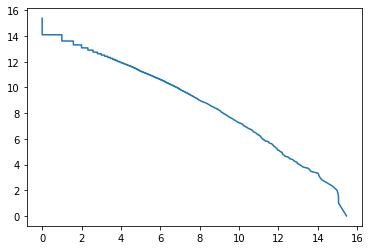

In [ ]:
import matplotlib.pyplot as plt
plt.plot(y,np.log2(x))

In [ ]:
#Calculate the frequency of the words inside
from operator import itemgetter
frequency = {}
for word in one_gram1 :
    count = frequency.get(word , 0)
    frequency[ word ] = count + 1

rank = 1
column_header = ['Rank', 'Frequency', 'Frequency * Rank']
df2 = pd.DataFrame( columns = column_header )
collection = sorted(frequency.items(), key=itemgetter(1), reverse = True)

In [ ]:
for word , freq in collection:
    df2.loc[word] = [rank, freq, rank*freq]
    rank = rank + 1
print ([df2])

[               Rank Frequency Frequency * Rank
magazine          1     19924            19924
great             2      6696            13392
articles          3      5891            17673
like              4      5094            20376
good              5      4953            24765
...             ...       ...              ...
resurrection  36351         1            36351
britaini      36352         1            36352
cultivation   36353         1            36353
analyzes      36354         1            36354
booksthe      36355         1            36355

[36355 rows x 3 columns]]


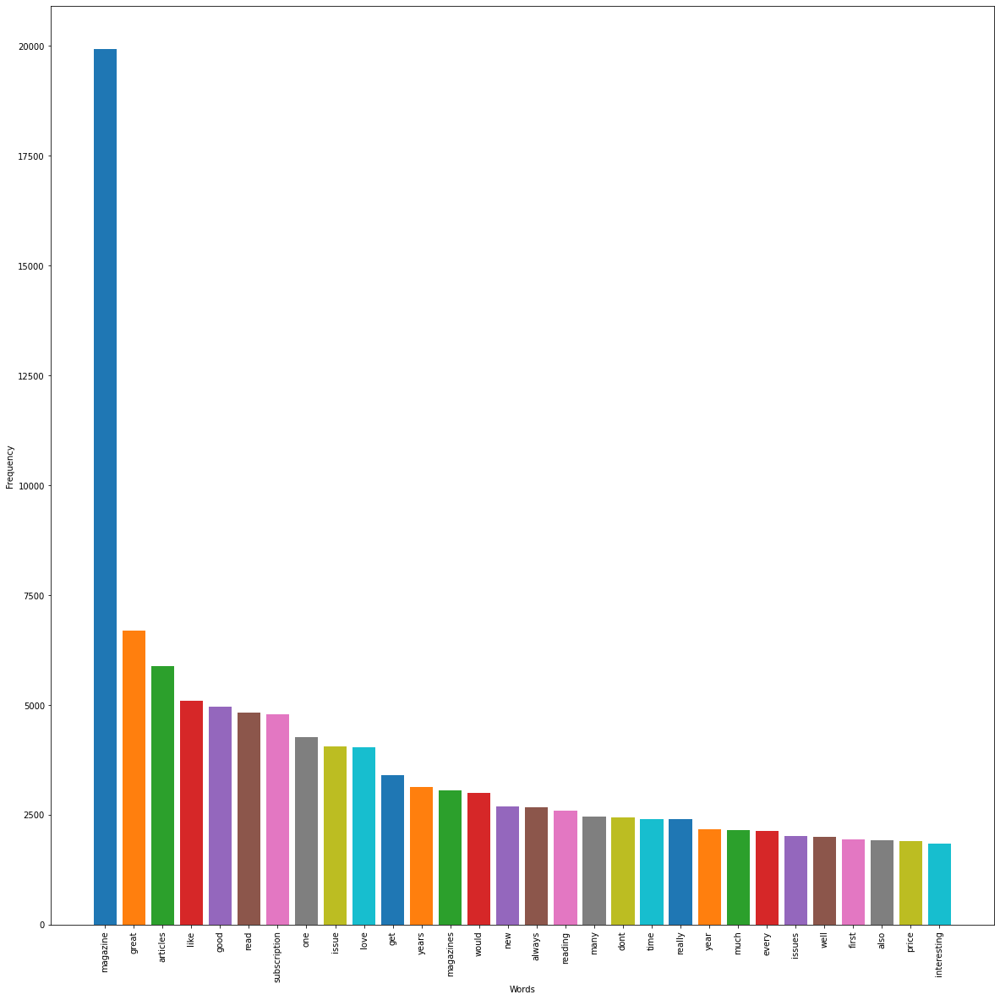

In [ ]:
#visualization with pyplot
plt.figure(figsize=(20,20))  #to increase the plot resolution
plt.ylabel("Frequency")
plt.xlabel("Words")
plt.xticks(rotation=90)    #to rotate x-axis values

for word , freq in collection[:30]:
    plt.bar(word, freq)    
plt.show()

In [ ]:
df2.tail()

,Rank,Frequency,Frequency * Rank
resurrection,36351,1,36351
britaini,36352,1,36352
cultivation,36353,1,36353
analyzes,36354,1,36354
booksthe,36355,1,36355


**4. Set of terms describing the corpus best**

In [ ]:
counts = [(w, one_gram1.count(w)) for w in one_gram1[:10000] ]
counts

[('computer', 247),
 ('enthusiast', 39),
 ('maxpc', 13),
 ('welcome', 26),
 ('sight', 20),
 ('mailbox', 138),
 ('remember', 265),
 ('years', 3136),
 ('savorying', 1),
 ('every', 2137),
 ('page', 843),
 ('boot', 13),
 ('called', 256),
 ('beginning', 137),
 ('still', 1682),
 ('obcessed', 1),
 ('pcs', 23),
 ('anyone', 585),
 ('advanced', 78),
 ('users', 50),
 ('beginners', 49),
 ('looking', 850),
 ('knowledge', 174),
 ('profit', 18),
 ('every', 2137),
 ('issue', 4048),
 ('maxpc', 13),
 ('icing', 4),
 ('cake', 13),
 ('subscription', 4784),
 ('comes', 376),
 ('cdrom', 6),
 ('packed', 101),
 ('demos', 55),
 ('utilities', 9),
 ('useful', 621),
 ('apps', 47),
 ('helpful', 567),
 ('blessed', 8),
 ('broadband', 4),
 ('connections', 10),
 ('discovered', 66),
 ('community', 35),
 ('hardware', 91),
 ('enthusiast', 39),
 ('web', 147),
 ('sites', 49),
 ('maxpc', 13),
 ('formerly', 10),
 ('boot', 13),
 ('really', 2395),
 ('informative', 809),
 ('source', 194),
 ('computing', 25),
 ('news', 615),
 ('ar

In [ ]:
[(w, c) for (w, c) in counts if c > 3000]

[('years', 3136),
 ('issue', 4048),
 ('subscription', 4784),
 ('articles', 5891),
 ('subscription', 4784),
 ('get', 3399),
 ('good', 4953),
 ('magazine', 19924),
 ('magazine', 19924),
 ('love', 4034),
 ('articles', 5891),
 ('magazine', 19924),
 ('articles', 5891),
 ('magazine', 19924),
 ('articles', 5891),
 ('like', 5094),
 ('magazine', 19924),
 ('one', 4260),
 ('articles', 5891),
 ('get', 3399),
 ('articles', 5891),
 ('like', 5094),
 ('good', 4953),
 ('articles', 5891),
 ('good', 4953),
 ('read', 4833),
 ('articles', 5891),
 ('magazine', 19924),
 ('magazine', 19924),
 ('magazine', 19924),
 ('read', 4833),
 ('articles', 5891),
 ('magazine', 19924),
 ('like', 5094),
 ('one', 4260),
 ('magazine', 19924),
 ('read', 4833),
 ('years', 3136),
 ('great', 6696),
 ('read', 4833),
 ('issue', 4048),
 ('magazine', 19924),
 ('great', 6696),
 ('magazines', 3052),
 ('good', 4953),
 ('read', 4833),
 ('years', 3136),
 ('articles', 5891),
 ('read', 4833),
 ('get', 3399),
 ('get', 3399),
 ('one', 4260),


# **Module - 2 (Sentiment Analysis using statistical NLP)-------------------------------------**

In [ ]:
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
stopset=set(stopwords.words('english'))

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
corpus = df["reviewText"].fillna(' ').values.tolist()
rating=df['overall'].values.tolist()
sentiment=df['Sentiment'].values.tolist()
bin_sentiment=df['Binary_Sentiment'].values.tolist()
print(bin_sentiment)

[1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

**1. (a) CountVectorizer**

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer 

# Create a Vectorizer Object 
vectorizer = CountVectorizer(lowercase=True, stop_words=stopset,) 

#tokenize and build vocab 
X_cv=vectorizer.fit_transform(corpus)  #25000x25711
print(X_cv[0])
print(vectorizer.get_feature_names())

# Printing the identified Unique words along with their indices 
print("Vocabulary: ", vectorizer.vocabulary_)

data = vectorizer.vocabulary_

#pd.Series().to_frame(vectorizer.vocabulary)
dic= pd.DataFrame.from_dict([data])
dic

  (0, 4956)	1
  (0, 7929)	2
  (0, 14304)	3
  (0, 25057)	1
  (0, 20819)	1
  (0, 13967)	1
  (0, 19067)	1
  (0, 25574)	1
  (0, 20041)	1
  (0, 8192)	2
  (0, 16430)	1
  (0, 3166)	2
  (0, 3696)	1
  (0, 2649)	1
  (0, 21913)	1
  (0, 15765)	1
  (0, 16700)	1
  (0, 1530)	1
  (0, 905)	1
  (0, 24387)	1
  (0, 2648)	1
  (0, 13682)	1
  (0, 12985)	1
  (0, 17908)	1
  (0, 12430)	1
  :	:
  (0, 22226)	1
  (0, 13955)	1
  (0, 24827)	1
  (0, 14502)	1
  (0, 7340)	1
  (0, 14407)	1
  (0, 14314)	1
  (0, 7799)	1
  (0, 15898)	1
  (0, 11895)	1
  (0, 6960)	1
  (0, 4627)	1
  (0, 7779)	1
  (0, 15039)	1
  (0, 2752)	1
  (0, 2399)	1
  (0, 3479)	1
  (0, 2035)	1
  (0, 24629)	1
  (0, 8018)	1
  (0, 23781)	1
  (0, 12433)	1
  (0, 14308)	1
  (0, 9883)	1
  (0, 11162)	1
['00', '000', '0000000001', '00005', '0006058434', '00s', '01', '0195366824', '02', '02081', '0235', '02809', '03', '0320', '0399146113', '04', '0465061796', '05', '05465', '0595472273', '06', '07', '0714838284', '0736063684', '08', '0801', '0812972821', '081297666

,computer,enthusiast,maxpc,welcome,sight,mailbox,remember,years,savorying,every,page,boot,called,beginning,still,obcessed,pc,anyone,advanced,users,beginners,looking,knowledge,profit,issue,icing,cake,subscription,comes,cd,rom,packed,demos,utilities,useful,apps,helpful,blessed,broadband,connections,...,bombarding,logo,referential,nikey,funner,lon,b00005n7sm,liv,christensen,misshapes,cobrasnake,dancing,doodles,visitbritain,scottish,duke,middleton,moniker,witchcraft,boscastle,witches,warlocks,paraphernalia,oak,regency,cheltenham,centre,hedgerows,irregularly,alluded,transitions,manson,rory,chivers,monet,walled,wye,resurrection,cultivation,analyzes
0,4956,7929,14304,25057,20819,13967,19067,25574,20041,8192,16430,3166,3696,2649,21913,15765,16700,1530,905,24387,2648,13682,12985,17908,12430,11430,3673,22224,4759,4008,19694,16418,6285,24408,24380,1650,10870,2955,3412,5088,...,3103,13653,18825,15506,9610,13659,2200,13576,4333,14739,4614,5925,7056,24700,20179,7287,14582,14889,25290,3194,25291,24891,16551,15755,18889,4223,4058,10821,12385,1226,23581,14093,19723,4296,14874,24843,25516,19393,5776,1390


**1.(b) TF-IDF**

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

#create transform
vectorizer2=TfidfVectorizer(use_idf=True, lowercase=True, stop_words=stopset)

#tokenize and build vocab
X_tfidf=vectorizer2.fit_transform(corpus) 
print(X_tfidf.shape)

#printing idf values
print(vectorizer2.idf_)

df5 = pd.DataFrame(X_tfidf[0].T.todense(), index=vectorizer2.get_feature_names(), columns=["TF-IDF"])
df5 = df5.sort_values('TF-IDF', ascending=False)
print (df5.head(25))

(25000, 25711)
[ 6.0768151   6.85000498 10.43352392 ... 10.43352392 10.43352392
 10.43352392]
               TF-IDF
maxpc        0.373384
boot         0.236606
computing    0.222767
enthusiast   0.208770
cd           0.190191
obcessed     0.145426
divx         0.145426
savorying    0.145426
codecs       0.145426
encoding     0.139774
merge        0.135764
icing        0.132654
broadband    0.130113
rom          0.126103
blessed      0.124461
utilities    0.122993
formerly     0.121664
connections  0.120452
bang         0.119336
audio        0.118303
cake         0.116442
sight        0.112651
profit       0.109149
welcome      0.109149
buck         0.107223


**1(c)Hashing Vectorizer**

In [ ]:
from sklearn.feature_extraction.text import HashingVectorizer
sentences = corpus
vectorizer = HashingVectorizer(norm = None, n_features = 25711)
sentence_vectors = vectorizer.fit_transform(sentences)
print(sentence_vectors[0])
#sent_arr =  sentence_vectors.toarray()

  (0, 18)	-1.0
  (0, 290)	-1.0
  (0, 471)	1.0
  (0, 576)	-1.0
  (0, 603)	-1.0
  (0, 1541)	1.0
  (0, 1607)	1.0
  (0, 2045)	1.0
  (0, 2287)	3.0
  (0, 2839)	-1.0
  (0, 2908)	1.0
  (0, 3259)	2.0
  (0, 3467)	-1.0
  (0, 3764)	3.0
  (0, 3961)	-2.0
  (0, 4273)	1.0
  (0, 4594)	1.0
  (0, 4761)	-1.0
  (0, 4834)	-1.0
  (0, 4872)	-1.0
  (0, 5219)	1.0
  (0, 5306)	2.0
  (0, 5315)	1.0
  (0, 5490)	1.0
  (0, 5602)	2.0
  :	:
  (0, 21125)	-1.0
  (0, 21275)	-1.0
  (0, 21354)	-1.0
  (0, 21706)	1.0
  (0, 22075)	-1.0
  (0, 23130)	-1.0
  (0, 23141)	1.0
  (0, 23190)	1.0
  (0, 23421)	-1.0
  (0, 23602)	-1.0
  (0, 23688)	-1.0
  (0, 23736)	-1.0
  (0, 24008)	-1.0
  (0, 24315)	-1.0
  (0, 24353)	-1.0
  (0, 24689)	1.0
  (0, 24877)	1.0
  (0, 25004)	1.0
  (0, 25142)	-5.0
  (0, 25225)	-2.0
  (0, 25309)	-1.0
  (0, 25516)	-1.0
  (0, 25568)	3.0
  (0, 25591)	1.0
  (0, 25619)	-2.0


**2. Sentiment Analysis Using following models**

**2.(a)Naive Bayes**

In [ ]:
import pandas as pd
from sklearn import naive_bayes
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score, accuracy_score, f1_score, confusion_matrix

using CountVectorizer

In [ ]:
X_train,X_test,Y_train,Y_test=train_test_split(X_cv,bin_sentiment,random_state=40)
print(X_test.shape)
print(X_test[:,1].shape)
clf1=naive_bayes.MultinomialNB()
clf1.fit(X_train,Y_train)
yp=clf1.predict(X_test)
print(Y_test)
print(yp)
print(accuracy_score(Y_test,yp))
print(f1_score(Y_test,yp))
print(confusion_matrix(Y_test,yp))

(6250, 25711)
(6250, 1)
[1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 

Using TF-IDF

In [ ]:
X_train,X_test,Y_train,Y_test=train_test_split(X_tfidf,bin_sentiment,random_state=40)
print(X_test.shape)
print(X_test[:,1].shape)
clf1=naive_bayes.MultinomialNB()
clf1.fit(X_train,Y_train)
yp=clf1.predict(X_test)
print(Y_test)
print(yp)
print(accuracy_score(Y_test,yp))
print(f1_score(Y_test,yp))
print(confusion_matrix(Y_test,yp))

(6250, 25711)
(6250, 1)
[1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 

**2(b)Decision Tree**

In [ ]:
from sklearn import tree

Using CountVectorizer

In [ ]:
X_train,X_test,Y_train,Y_test=train_test_split(X_cv,bin_sentiment,random_state=40)

clf3=tree.DecisionTreeClassifier()
clf3.fit(X_train,Y_train)
yp=clf3.predict(X_test)
print(Y_test)
print(yp)
print(accuracy_score(Y_test,yp))
print(f1_score(Y_test,yp))
print(confusion_matrix(Y_test,yp))

[1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0,

Using TF-IDF

In [ ]:
X_train,X_test,Y_train,Y_test=train_test_split(X_tfidf,bin_sentiment,random_state=40) #25% test data and 75% train data

clf3=tree.DecisionTreeClassifier()
clf3.fit(X_train,Y_train)
yp=clf3.predict(X_test)
print(Y_test)
print(yp)
print(accuracy_score(Y_test,yp))
print(f1_score(Y_test,yp))
print(confusion_matrix(Y_test,yp))

[1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0,

**2(c)Logistic Regression**

In [ ]:
from sklearn.linear_model import LogisticRegression

Using CountVectorizer

In [ ]:
X_train,X_test,Y_train,Y_test=train_test_split(X_cv,bin_sentiment,random_state=40)
print(X_test.shape)
print(X_test[:,1].shape)
clf2=LogisticRegression()
clf2.fit(X_train,Y_train)
yp=clf2.predict(X_test)
print(Y_test)
print(yp)
print(accuracy_score(Y_test,yp))
print(f1_score(Y_test,yp))
print(confusion_matrix(Y_test,yp))

(6250, 25711)
(6250, 1)
[1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


Using TF-IDF

In [ ]:
X_train,X_test,Y_train,Y_test=train_test_split(X_tfidf,bin_sentiment,random_state=40)
print(X_test.shape)
print(X_test[:,1].shape)
clf2=LogisticRegression()
clf2.fit(X_train,Y_train)
yp=clf2.predict(X_test)
print(Y_test)
print(yp)
print(accuracy_score(Y_test,yp))
print(f1_score(Y_test,yp))
print(confusion_matrix(Y_test,yp))

(6250, 25711)
(6250, 1)
[1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 

In [ ]:
import numpy as np
import pandas as pd
import re, nltk, spacy, gensim

from sklearn.decomposition import LatentDirichletAllocation, TruncatedSVD
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import GridSearchCV
from pprint import pprint

In [ ]:
# Build LDA Model
lda_model = LatentDirichletAllocation(n_components=5, # Number of topics
                                      max_iter=10,               
# Max learning iterations
                                      learning_method='online',   
                                      random_state=100,          
# Random state
                                      batch_size=128,            
# n docs in each learning iter
                                      evaluate_every = -1,       
# compute perplexity every n iters, default: Don't
                                      n_jobs = -1,               
# Use all available CPUs
                                     )
lda_output = lda_model.fit_transform(X_cv)
print(lda_model)  # Model attributes


LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
                          evaluate_every=-1, learning_decay=0.7,
                          learning_method='online', learning_offset=10.0,
                          max_doc_update_iter=100, max_iter=10,
                          mean_change_tol=0.001, n_components=5, n_jobs=-1,
                          perp_tol=0.1, random_state=100, topic_word_prior=None,
                          total_samples=1000000.0, verbose=0)


In [ ]:
# Log Likelyhood: Higher the better
print("Log Likelihood: ", lda_model.score(X_cv))
# Perplexity: Lower the better. Perplexity = exp(-1. * log-likelihood per word)
print("Perplexity: ", lda_model.perplexity(X_cv))
# See model parameters
pprint(lda_model.get_params())

Log Likelihood:  -4576154.315001247
Perplexity:  2292.9264546550253
{'batch_size': 128,
 'doc_topic_prior': None,
 'evaluate_every': -1,
 'learning_decay': 0.7,
 'learning_method': 'online',
 'learning_offset': 10.0,
 'max_doc_update_iter': 100,
 'max_iter': 10,
 'mean_change_tol': 0.001,
 'n_components': 5,
 'n_jobs': -1,
 'perp_tol': 0.1,
 'random_state': 100,
 'topic_word_prior': None,
 'total_samples': 1000000.0,
 'verbose': 0}


In [ ]:
# Create Document — Topic Matrix
lda_output = lda_model.transform(X_cv)

# column names
topicnames = ['Topic' + str(i) for i in range(lda_model.n_components)]

# index names
docnames = ['Doc' + str(i) for i in range(len(corpus))]

# Make the pandas dataframe
df_document_topic = pd.DataFrame(np.round(lda_output, 2), columns=topicnames, index=docnames)

# Get dominant topic for each document
dominant_topic = np.argmax(df_document_topic.values, axis=1)
df_document_topic['dominant_topic'] = dominant_topic

# Styling
def color_green(val):
 color = 'green' if val > .1 else 'black'
 return 'color: {col}'.format(col=color)
def make_bold(val):
 weight = 700 if val > .1 else 400
 return 'font-weight: {weight}'.format(weight=weight)

# Apply Style
df_document_topics = df_document_topic.head(15).style.applymap(color_green).applymap(make_bold)
df_document_topics

,Topic0,Topic1,Topic2,Topic3,Topic4,dominant_topic
Doc0,0.100000,0.160000,0.290000,0.070000,0.380000,4
Doc1,0.010000,0.220000,0.510000,0.010000,0.250000,2
Doc2,0.010000,0.590000,0.000000,0.400000,0.000000,1
Doc3,0.010000,0.450000,0.010000,0.530000,0.010000,3
Doc4,0.040000,0.840000,0.040000,0.040000,0.040000,1
Doc5,0.010000,0.940000,0.010000,0.010000,0.010000,1
Doc6,0.010000,0.200000,0.690000,0.000000,0.090000,2
Doc7,0.020000,0.220000,0.020000,0.020000,0.730000,4
Doc8,0.020000,0.480000,0.020000,0.190000,0.300000,1
Doc9,0.010000,0.330000,0.230000,0.420000,0.010000,3


In [ ]:
# Topic-Keyword Matrix
df_topic_keywords = pd.DataFrame(lda_model.components_)
# Assign Column and Index
df_topic_keywords.columns = vectorizer.get_feature_names()
df_topic_keywords.index = topicnames
# View
df_topic_keywords.head()

,00,000,0000000001,00005,0006058434,00s,01,0195366824,02,02081,0235,02809,03,0320,0399146113,04,0465061796,05,05465,0595472273,06,07,0714838284,0736063684,08,0801,0812972821,0812976665,09,10,100,1000,100000,1000f,100k,100x,101,102,1022,103,...,zero,zeroes,zeroing,zest,zeta,zetia,ziff,zillion,zillions,zim,zimbabwe,zinczenko,zine,zines,zinio,zion,zip,zipped,zipusa,zizzy,zombie,zombies,zondervan,zone,zones,zoo,zooey,zoolander,zoology,zoom,zoomed,zooming,zoon,zp,zsa,zucchini,zune,zurich,zx,zzz
Topic0,0.203604,48.782457,0.202138,0.201355,0.832754,0.215877,0.203223,0.885570,0.202492,1.029897,0.200001,0.200006,0.206131,0.200392,1.354482,0.211527,0.885570,0.203641,0.200004,0.893740,0.202013,0.236498,0.202997,0.832754,0.203599,0.201050,0.932835,0.932891,0.201502,157.241314,37.649196,7.388154,0.200009,0.201384,1.583922,0.804817,12.796279,0.204589,0.200002,0.205190,...,0.208830,0.204815,0.201126,1.599861,0.201490,0.201988,0.200001,0.953880,0.597579,1.257323,0.205273,0.200003,10.141555,0.200424,0.200716,0.200007,0.206440,0.200003,0.200003,1.703539,3.639146,1.168376,0.201700,0.201296,0.202057,0.201707,1.935609,1.327962,0.201165,0.200769,0.200696,0.200728,0.200003,0.200026,0.205826,0.201719,0.201415,0.202241,0.200005,0.205600
Topic1,0.202722,0.860732,0.202183,0.201248,0.200388,0.202213,0.203910,0.200000,0.201337,0.210045,0.200000,0.200002,0.204182,0.200620,0.201989,0.209949,0.200000,0.201277,0.200002,0.200970,0.202874,0.200926,0.206786,0.200388,0.200618,0.200002,0.200000,0.200000,0.200619,76.513465,28.404309,5.775672,0.889434,0.201569,0.201082,0.207869,0.211352,0.203366,0.200001,0.214045,...,0.203700,0.203522,0.211816,0.202596,0.201872,0.202675,0.200842,0.201531,0.201401,0.200001,1.693419,0.202132,0.209005,0.201715,0.203163,0.201160,0.205663,0.205766,0.209601,0.201419,0.204797,0.201226,0.201034,0.203221,0.200985,0.202336,0.203547,0.211925,0.206653,0.201907,0.200995,0.201167,0.202838,0.200009,0.202592,0.201854,0.203084,0.203788,0.200002,0.207121
Topic2,0.202957,0.312731,1.038090,0.790041,0.203620,0.202927,0.210585,0.201033,0.205583,0.201906,0.201957,0.203181,4.143647,0.200861,0.204861,0.207986,0.201033,0.201756,0.200006,0.207453,0.207807,0.214882,0.204314,0.203620,0.201346,0.215698,0.201395,0.201394,0.200712,5.945002,29.319457,0.221993,0.200012,0.202454,0.205685,0.200004,0.229395,4.855828,0.789973,0.208045,...,0.205339,1.055080,0.201422,0.204422,0.200011,1.681465,1.969371,0.203036,0.204736,0.200006,0.227013,0.826059,0.216312,6.032677,0.243145,1.632669,15.181779,0.200757,0.204424,0.207716,0.204947,0.684022,1.911441,0.204508,2.108687,0.201279,0.200016,0.205047,0.201302,71.532624,7.118483,22.600919,1.249662,1.421579,0.200002,0.204007,1.715254,0.200003,0.201195,0.203603
Topic3,0.203283,42.588960,0.202692,0.200252,0.201725,0.215424,0.203735,0.200642,0.201985,0.295129,0.203257,1.521080,0.205626,0.200531,0.205837,0.211038,0.200642,0.897397,0.202156,0.202820,0.201766,0.204616,1.317270,0.201725,0.201188,0.200006,0.210738,0.210683,0.201238,4.359898,22.002908,0.206570,0.202263,1.044243,0.201124,0.200890,0.213484,0.206279,0.200002,0.796833,...,7.057876,0.201874,3.121559,0.202651,0.202056,0.202077,0.200001,0.201040,1.128480,0.205359,0.217410,0.200003,0.205560,0.201206,0.203661,0.200008,0.253061,0.201891,1.597867,0.200002,0.474531,0.201607,0.201674,10.121956,0.204644,2.220619,0.200014,0.202035,3.618602,0.200864,0.200391,0.200557,0.201483,0.200032,1.897321,1.551052,0.206085,1.431518,0.990979,0.903103
Topic4,194.657608,0.204168,0.200689,0.202422,0.201266,1.331602,12.166730,0.200000,5.169123,0.207261,0.971120,0.208477,11.406263,1.589867,0.200873,15.564318,0.200000,16.920780,1.550152,0.200001,9.897778,9.214390,0.202739,0.201266,23.097960,1.403961,0.200546,0.200546,26.049801,366.821431,11.759886,0.205790,0.206121,0.200402,0.203837,0.200419,0.206800,0.200703,0.202279,0.209110,...,46.963477,0.202000,0.200861,0.200289,1.586843,0.201588,0.200473,0.201293,0.201849,0.206271,0.201519,0.201783,0.211509,0.201043,13.611076,0.206421,0.204146,0.818338,0.200760,0.201195,0.

In [ ]:
# Show top n keywords for each topic
def show_topics(vectorizer=vectorizer, lda_model=lda_model, n_words=5):
    keywords = np.array(vectorizer.get_feature_names())
    topic_keywords = []
    for topic_weights in lda_model.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords
topic_keywords = show_topics(vectorizer=vectorizer, lda_model=lda_model, n_words=5)
# Topic - Keywords Dataframe
df_topic_keywords = pd.DataFrame(topic_keywords)
df_topic_keywords.columns = ['Word '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords.index = ['Topic '+str(i) for i in range(df_topic_keywords.shape[0])]
df_topic_keywords

,Word 0,Word 1,Word 2,Word 3,Word 4
Topic 0,fashion,women,health,like,magazine
Topic 1,magazine,great,articles,good,read
Topic 2,kindle,new,read,monthly,fire
Topic 3,national,geographic,food,issue,living
Topic 4,magazine,subscription,issue,year,amazon


In [ ]:
doc_complete = df['reviewText'][:25000]
doc_complete
#corpus = df["reviewText"].fillna(' ').values.tolist()
doc_complete1 = doc_complete.values.tolist()
print(doc_complete1[:10])
nltk.download('punkt')

['for computer enthusiast, MaxPC is a welcome sight in your mailbox. i can remember for years savorying every page of "boot" (as it was called in beginning) as i was (and still am) obcessed with PC\'s. Anyone, from advanced users - to beginners looking for knowledge - can profit from every issue of MaxPC. the icing on the cake is the subscription that comes with a CD-ROM as it is packed with demos, utilities, and other useful apps (very helpful for those not blessed with broadband connections). Until I discovered the community of hardware enthusiast web sites, MaxPC, formerly "boot", was my only really informative source for computing news and articles. To this day, i consider my subscription to it worth more than 10 subscriptions to most other computing mags. I can\'t wait until they merge with DVD media and maybe end up offering more info on Divx codecs, encoding your own movies, and best bang for the buck audio and video equipment. Try a few issues (with CD)and you may get hooked...

True

In [ ]:
from nltk.corpus import brown

from nltk import sent_tokenize, word_tokenize
#str_corpus = str(corpus)
#str_corpus_0 = corpus[0]
str_corpus_1 = str(doc_complete1[:100])
print('Sentences for the word : kindle\n',[i for i in sent_tokenize(str_corpus_1) if "kindle" in word_tokenize(i)])
print(i)

Sentences for the word : kindle
 ['That was a relief!\\n\\nI also like the fact that the magazine deals with both computer hardware, and software - though the emphasis is on hardware.\\n\\nThere are also letters to the computer doctor who diagnoses and then gives good advice on a range of computer illnesses and hiccups.\\n\\nYou also get the latest news taking place in the tech world and on copyright issues.\\n\\nOverall It is a well rounded publication with a little for everyone, young and old, great and small.\\n\\nI have the kindle for Ipad version, and it is the absolute best.']
The English Garden is a wonderful gardening magizine for serious gardeners. It has great practical advice, and good articles. Also, the photography is very good, makes you believe you might be able to do some of this. A great source for gardening supplies.


In [ ]:
str_corpus_1 = str(doc_complete1[:100])
print('Sentences for the word : subscription',[i for i in sent_tokenize(str_corpus_1) if "subscription" in word_tokenize(i)])

Sentences for the word : subscription ['the icing on the cake is the subscription that comes with a CD-ROM as it is packed with demos, utilities, and other useful apps (very helpful for those not blessed with broadband connections).', 'To this day, i consider my subscription to it worth more than 10 subscriptions to most other computing mags.', 'Maximum PC covers much more hardware and digs deeper.\\n\\nYou can subscribe (puchase) the magazine by going to [...]  1 year subscription ( 12 issues) is $19.95.', '\', \'I started off in the early days with a "Boot" subscription that eventually morphed itself into Maximum PC.', 'Maximum PC, PC Gamer and Computer Shopper were required reading for me in my early years of computer building and upgrading.\\n\\nFast forward many years later and I finally let me subscription lapse and never renewed.', "I've been reading Max PC for years, and now with my subscription I'm saving money on the mag,and from having to run around from store to store to ge

In [ ]:
str_corpus_1 = str(doc_complete1[:100])
print('Sentences for the word : article',[i for i in sent_tokenize(str_corpus_1) if "article" in word_tokenize(i)])

Sentences for the word : article ['Each title points out exactly what the article covers, leaving nothing to the imagination.\\n\\nThe writing in Antiques is certainly good and well- edited.', 'A web address or toll-free number to order the product follows the article.', 'I love the "How To 101" series they have in the magazine every month, it\\\'s so handy and it teaches you everything about whatever that month\\\'s article is about.', "Inside, there is an article written by celeb makeup artist, Kevyn Aucoin, who always has great advice for us on how to makeup in everyday life, as well as tell us about the glamorous world he\\'s in.", 'Their only saving grace is that they are so short (which is a problem when you run across the occasionally well-done, interesting article).', 'I would cancel it if I had a chance of getting my money back.\\n\\nUpdate:  The issues have become slightly more inclusive lately, with an article or two per issue not intended for the gaming community (i.e.']
